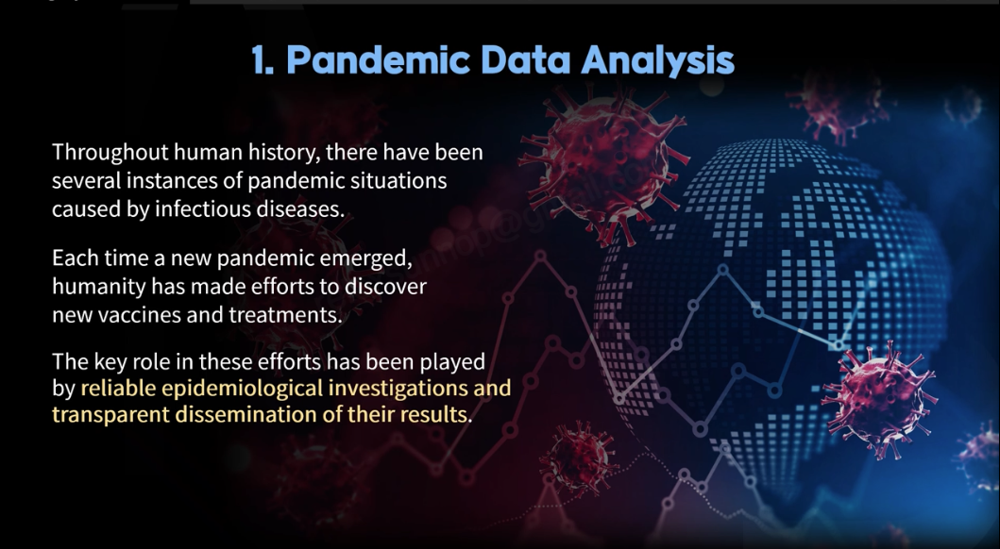

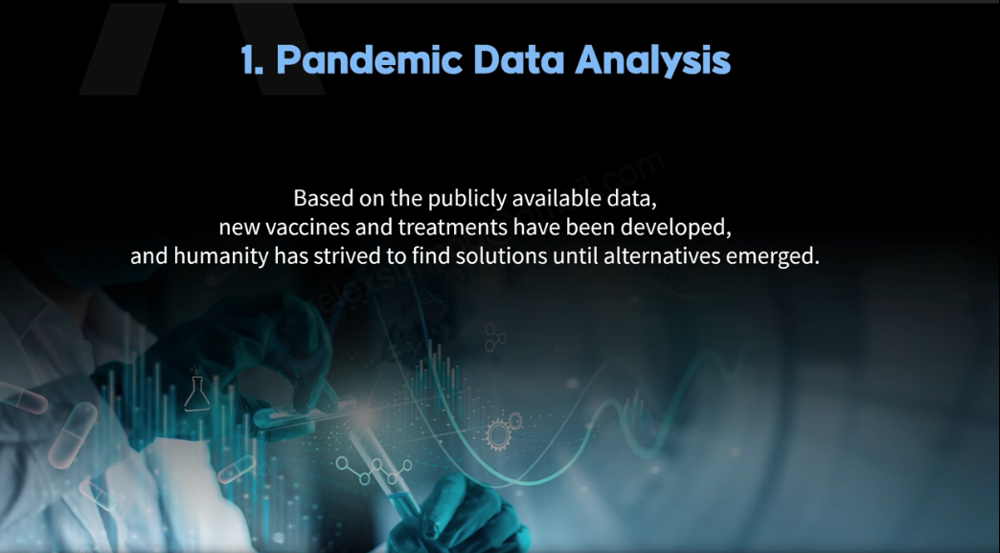

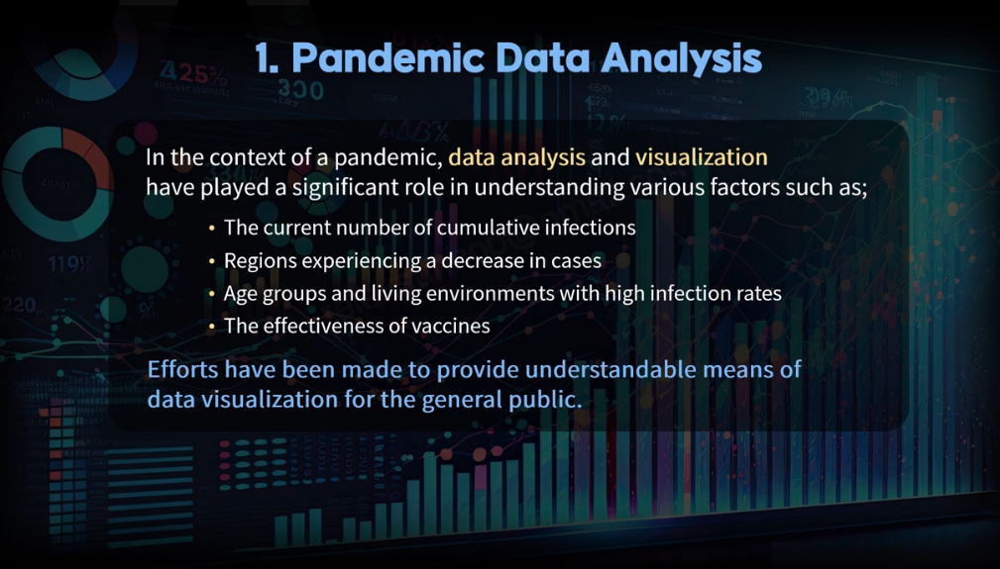

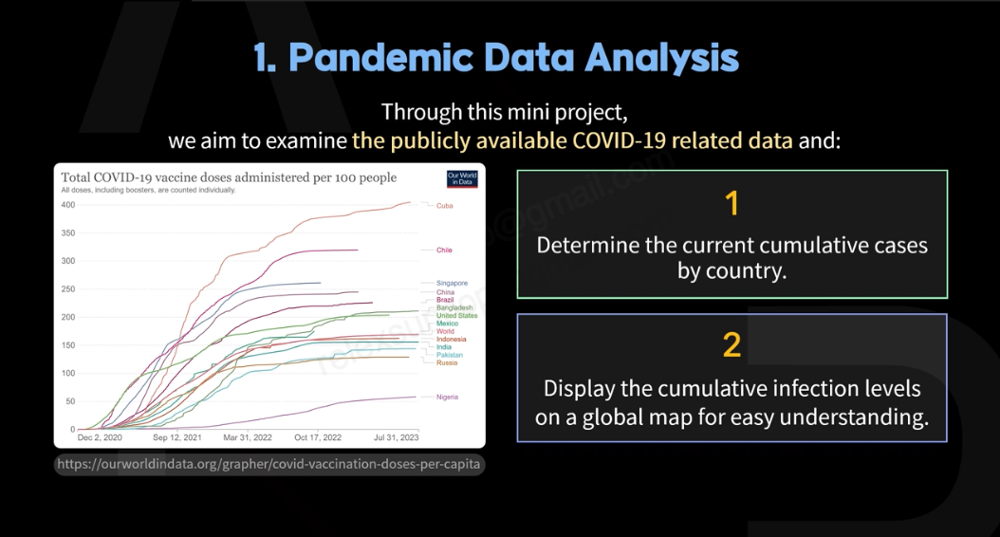

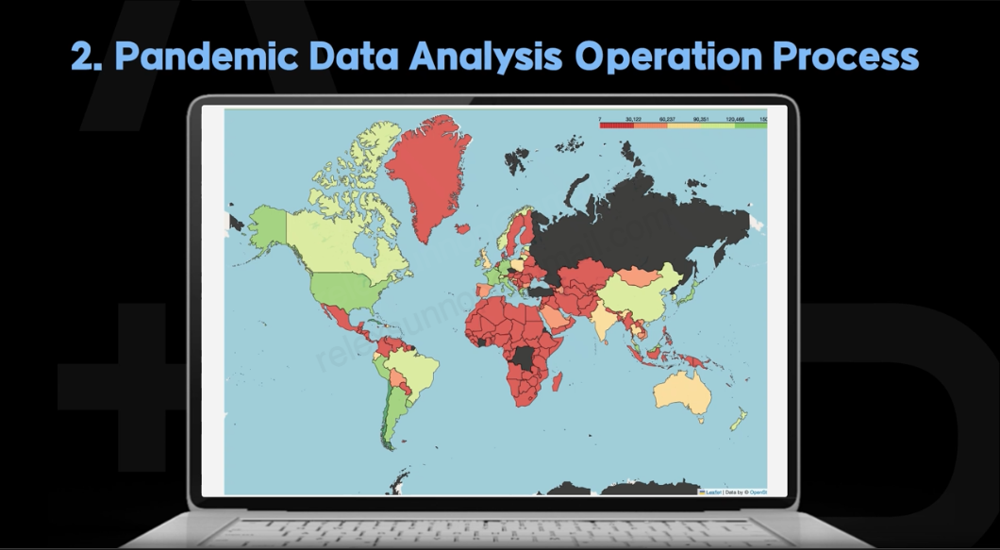

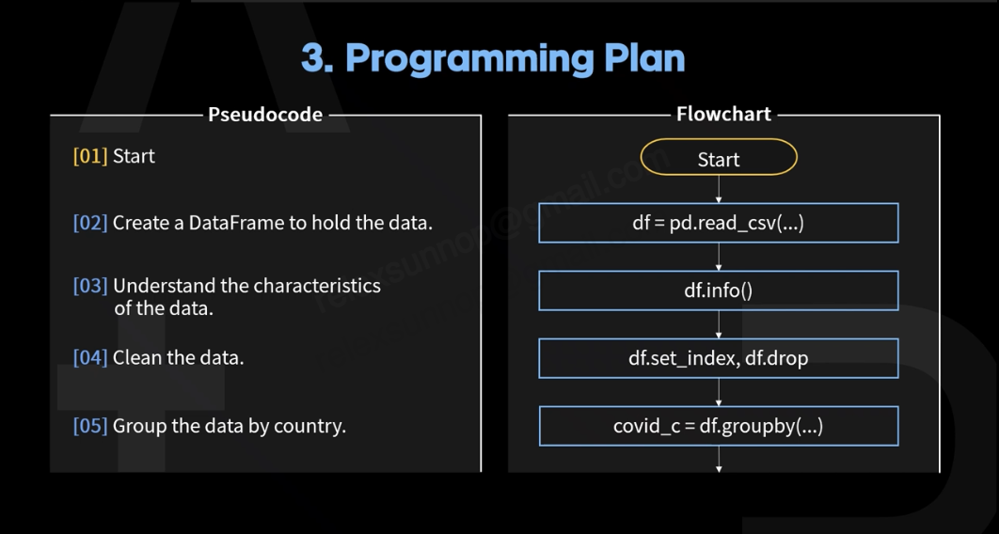

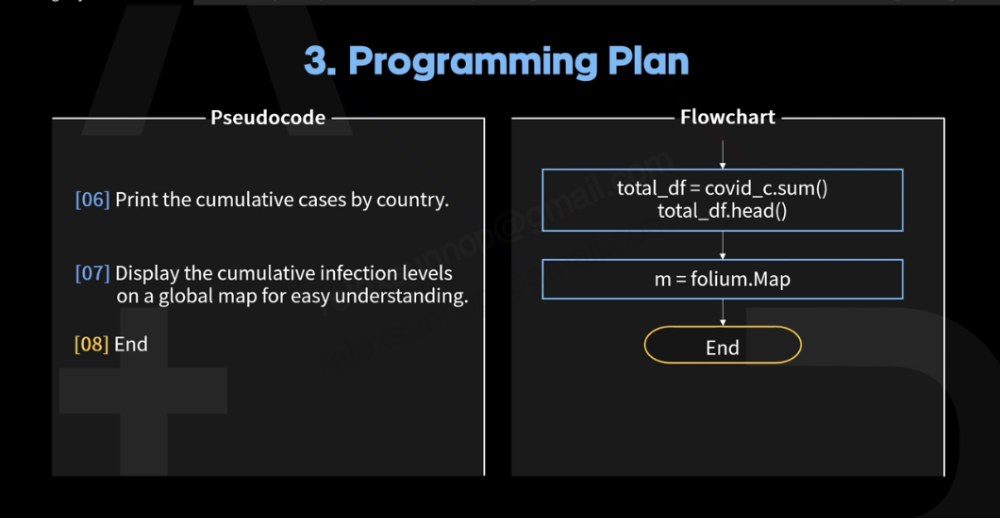

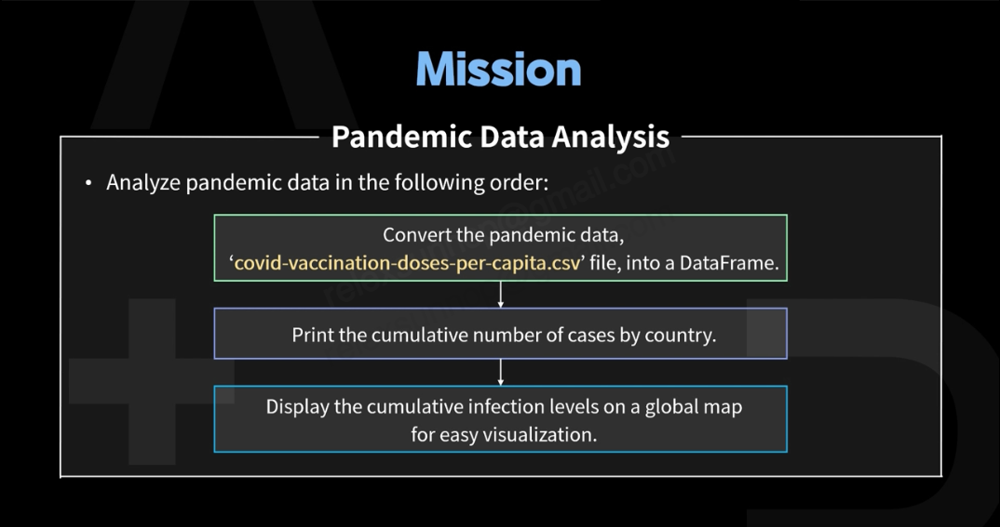

In [6]:
import pandas as pd

df = pd.read_csv("./data/covid-vaccination-doses-per-capita.csv")
df.head()

,Entity,Code,Day,total_vaccinations_per_hundred
0,Afghanistan,AFG,2021-02-22,0.00
1,Afghanistan,AFG,2021-02-28,0.02
2,Afghanistan,AFG,2021-03-16,0.13
3,Afghanistan,AFG,2021-04-07,0.29
4,Afghanistan,AFG,2021-04-22,0.58


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 79708 entries, 0 to 79707
Data columns (total 4 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Entity                          79708 non-null  object 
 1   Code                            64681 non-null  object 
 2   Day                             79708 non-null  object 
 3   total_vaccinations_per_hundred  79708 non-null  float64
dtypes: float64(1), object(3)
memory usage: 2.4+ MB


In [9]:
df['Date'] = pd.to_datetime(df['Day'])
df.set_index('Date', inplace = True)
df.drop(['Day'], axis = 1, inplace = True)

df.head()

,Entity,Code,total_vaccinations_per_hundred,Data
Date,,,,
2021-02-22,Afghanistan,AFG,0.00,2021-02-22
2021-02-28,Afghanistan,AFG,0.02,2021-02-28
2021-03-16,Afghanistan,AFG,0.13,2021-03-16
2021-04-07,Afghanistan,AFG,0.29,2021-04-07
2021-04-22,Afghanistan,AFG,0.58,2021-04-22


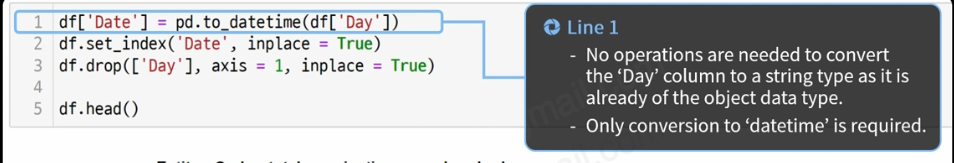

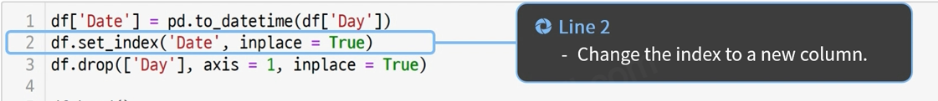

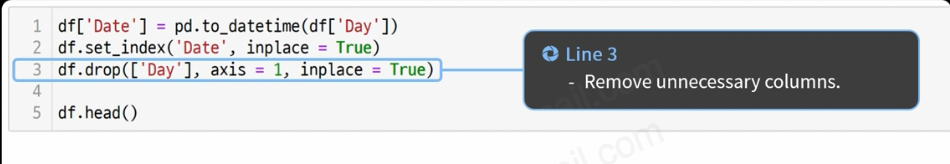

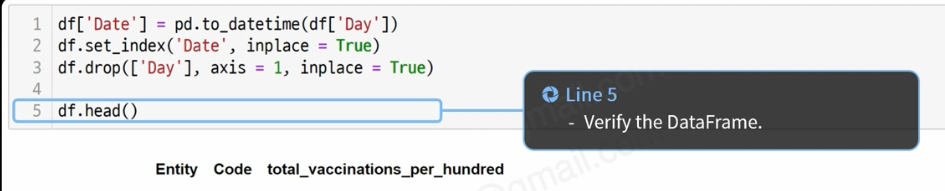

In [10]:
len(df['Entity'].unique())

236

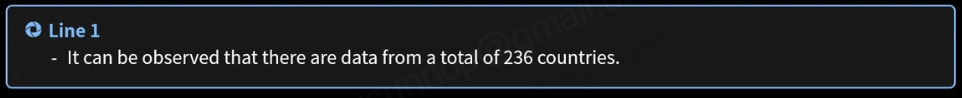

In [11]:
covid_c = df.groupby('Entity')

In [12]:
for key, group in covid_c :
    print('+key:', key)
    print('+number', len(group))
    print(group.head())
    print('\n')

+key: Afghanistan
+number 141
                 Entity Code  total_vaccinations_per_hundred       Data
Date                                                                   
2021-02-22  Afghanistan  AFG                            0.00 2021-02-22
2021-02-28  Afghanistan  AFG                            0.02 2021-02-28
2021-03-16  Afghanistan  AFG                            0.13 2021-03-16
2021-04-07  Afghanistan  AFG                            0.29 2021-04-07
2021-04-22  Afghanistan  AFG                            0.58 2021-04-22


+key: Africa
+number 982
            Entity Code  total_vaccinations_per_hundred       Data
Date                                                              
2021-01-09  Africa  NaN                             0.0 2021-01-09
2021-01-10  Africa  NaN                             0.0 2021-01-10
2021-01-11  Africa  NaN                             0.0 2021-01-11
2021-01-12  Africa  NaN                             0.0 2021-01-12
2021-01-13  Africa  NaN              

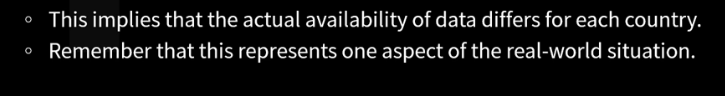

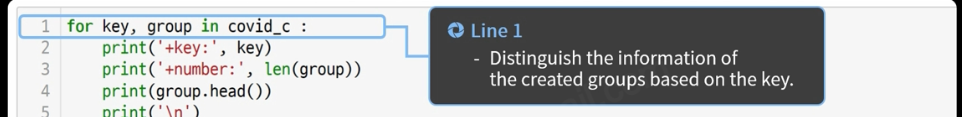

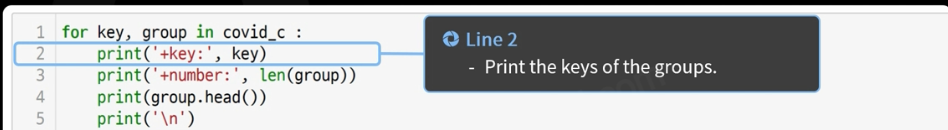

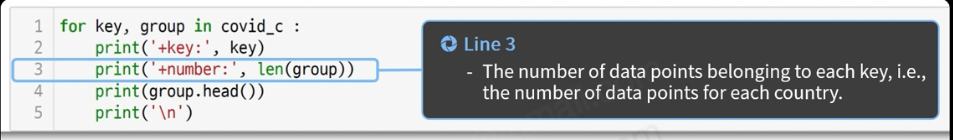

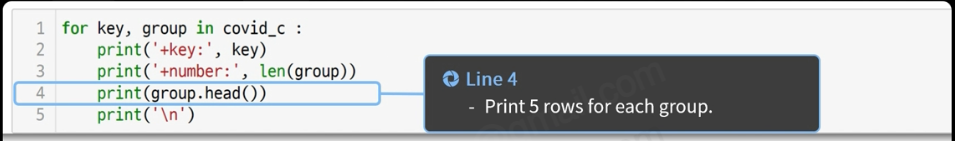

In [13]:
total_df = covid_c.sum(numeric_only = True)
total_df.head()

,total_vaccinations_per_hundred
Entity,
Afghanistan,3551.54
Africa,30647.20
Albania,13692.69
Algeria,664.55
Andorra,6928.74


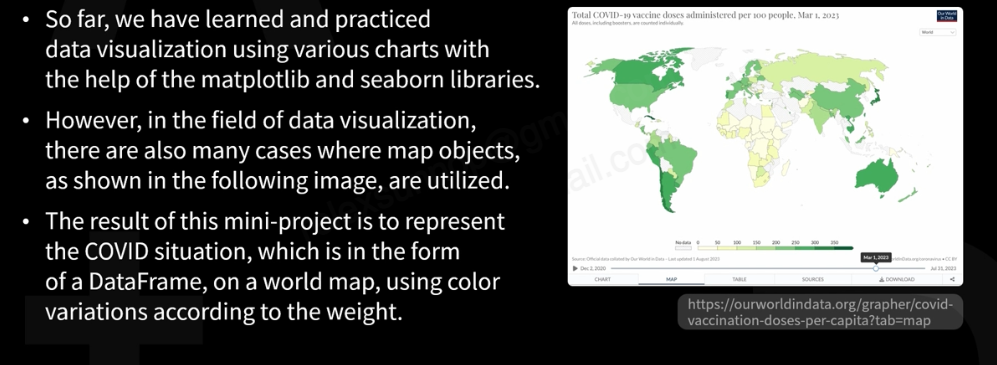

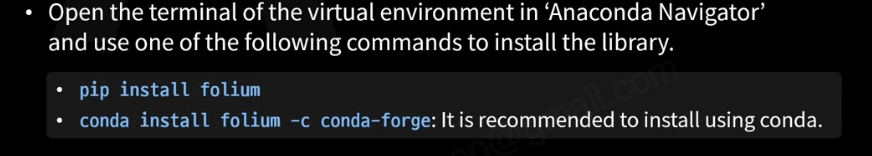

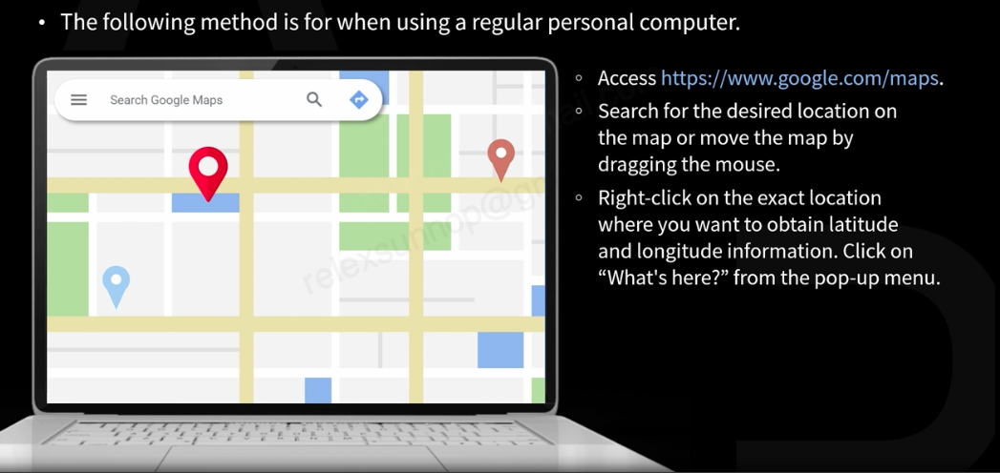

In [14]:
import folium

map = folium.Map(location = [11.596479082415195, 104.92570173143957],
                zoom_start = 13,
                )

map

In [15]:
import folium

map = folium.Map(location = [11.596479082415195, 104.92570173143957],
                zoom_start = 13,
                )

map.save('my_map.html')

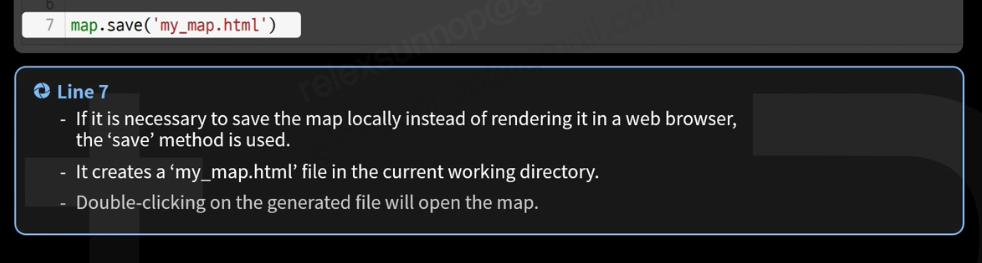

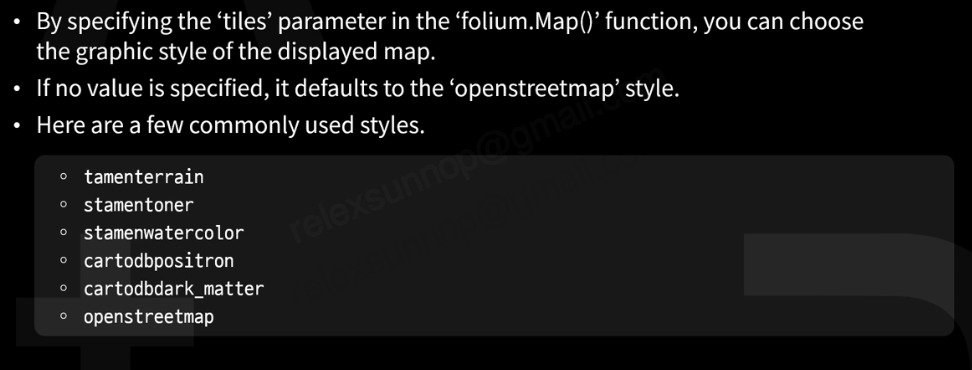

In [1]:
import folium

map = folium.Map(location = [11.596479082415195, 104.92570173143957],
                zoom_start = 13,
                tiles = 'stamenwatercolor'
                )

map

In [7]:
marker_map = folium.Map(location = [11.596479082415195, 104.92570173143957],
                zoom_start = 13,
                tiles = 'stamen Terrain'
                )

folium.Marker(
    location = [11.596479082415195, 104.92570173143957],
    popup = 'Phnom Penh',
    icon = folium.Icon(icon = 'cloud'),
).add_to(marker_map)

folium.Marker(
    location = [11.599767329219365, 104.88537069166964],
    popup = 'Aeon2',
    icon = folium.Icon(icon = 'green')
).add_to(marker_map)

folium.CircleMarker(
    location = [11.48517913893891, 104.91810455247077],
    radius = 100,
    popup = 'circle',
    fill = True,
    fill_color = '#3186cc'
).add_to(marker_map)

marker_map


In [8]:
import pandas as pd

url = ('https://raw.githubusercontent.com/python-visualization/folium/master/examples/data')
state_geo = f"{url}/us-states.json"
state_unemployment = f"{url}/US_Unemployment_Oct2012.csv"
state_data = pd.read_csv(state_unemployment)

m = folium.Map(location = [48, -102], zoom_start = 3)

folium.Choropleth(
    geo_data = state_geo,
    name = 'choropleth',
    data = state_data,
    columns = ['State', 'Unemployment'],
    key_on = 'feature.id',
    fill_color = 'YlGn',
    fill_opacity = 0.7,
    line_opacity = 0.2,
    legend_name = "Unemployment Rate (%)",
).add_to(m)

folium.LayerControl().add_to(m)

m


In [12]:
import folium
import json

center = [35.762887375145795, 84.08313219586536]

m = folium.Map(location = center, zoom_start = 2,
               max_bounds = True,
               min_zoom = 1, min_lat = -84, 
               max_lat = 84, min_lon = -175, max_lon = 187)

geo_path = "./data/World_Countries_Generalized.geojson"

json_data = json.load(open(geo_path, encoding = 'utf-8'))

folium.Choropleth(geo_data = json_data,
                  data = total_df,
                  columns = (total_df.index, 'total_vaccinations_per_hundred'),
                  key_on = 'properties.COUNTRY',
                  fill_color = 'RdYlGn',
                  fill_opacity = 0.7,
                  line_opacity = 0.5,
                 ).add_to(m)


folium.LayerControl().add_to(m)
m

In [10]:
import pandas as pd
import folium
import json

df = pd.read_csv("./data/covid-vaccination-doses-per-capita.csv")
print(df.head())

print('\n <Basic information for data>')
print(df.info())

print('\n <Data tidying>')
df['Date'] = pd.to_datetime(df['Day'])
df.set_index('Date', inplace = True)
df.drop(['Day'], axis = 1, inplace = True)
print(df.head())

print('\n <Accumulation by country>')
covid_c = df.groupby(['Entity'])
total_df = covid_c.sum(numeric_only = True)
print(total_df.head())

center = [35.762887375145795, 84.08313219586536]

m = folium.Map(location = center, zoom_start = 2,
               max_bounds = True,
               min_zoom = 1, min_lat = -84, 
               max_lat = 84, min_lon = -175, max_lon = 187)

geo_path = "./data/World_Countries_Generalized.geojson"

json_data = json.load(open(geo_path, encoding = 'utf-8'))

folium.Choropleth(geo_data = json_data,
                  data = total_df,
                  columns = (total_df.index, 'total_vaccinations_per_hundred'),
                  key_on = 'properties.COUNTRY',
                  fill_color = 'RdYlGn',
                  fill_opacity = 0.7,
                  line_opacity = 0.5,
                 ).add_to(m)


folium.LayerControl().add_to(m)
m

        Entity Code         Day  total_vaccinations_per_hundred
0  Afghanistan  AFG  2021-02-22                            0.00
1  Afghanistan  AFG  2021-02-28                            0.02
2  Afghanistan  AFG  2021-03-16                            0.13
3  Afghanistan  AFG  2021-04-07                            0.29
4  Afghanistan  AFG  2021-04-22                            0.58

 <Basic information for data>
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 79708 entries, 0 to 79707
Data columns (total 4 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Entity                          79708 non-null  object 
 1   Code                            64681 non-null  object 
 2   Day                             79708 non-null  object 
 3   total_vaccinations_per_hundred  79708 non-null  float64
dtypes: float64(1), object(3)
memory usage: 2.4+ MB
None

 <Data tidying>
                 Entity Code  total_v